In [2]:
import warnings
warnings.simplefilter("ignore", UserWarning)
warnings.filterwarnings("ignore")

import zipfile
from urllib.request import urlopen
import dask.bag as db
import dask.dataframe as dd
import pandas as pd
from dask.distributed import Client

import plotly.express as px
import numpy as np
import datetime
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.ticker as mtick
from matplotlib.pyplot import xticks
import matplotlib.dates as dates
matplotlib.style.use('seaborn')

import calplot
from folium.plugins import TimeSliderChoropleth
import folium
import branca.colormap as cm
import geopandas as gpd
import fiona
from shapely.geometry import Polygon, mapping
import shapefile

fiona.drvsupport.supported_drivers['KML'] = 'rw'
fiona.drvsupport.supported_drivers['LIBKML'] = 'rw'

# printing
from IPython.display import Markdown, display
def printmd(string):
    display(Markdown(string))

In [3]:
from IPython.display import HTML, display
import pprint

In [4]:
pp = pprint.PrettyPrinter(indent=4, width=100)


HTML('''
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}


</style>


<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>
''')

<img src="banner.png"/>

# Comparing travel behavior during 2019 and 2020 in the New York City Taxi and Limousine Commission trip records

by Nika Karen Espiritu and Jasper Pangan

<div><span style="background-color: #425564; padding-top: 100px; padding-right: 20px; padding-bottom: 50px; padding-left: 20px; color: #ffffff; font-size: 20px; font-weight: bold">EXECUTIVE SUMMARY </span></div>

New York declared their first COVID-19 case on March 1, 2020.  Since then, it has turned local economy upside down and spelled the deaths of thousands of people.  For the safety of its people, the government has issued strict stay-at-home orders.  For the New York taxi drivers, this has endangered their livelihoods and families.  In this paper, we ask how travel patterns and behaviors have changed from 2019 to 2020 with the pandemic in place.  To answer this question, we gathered data from the New York City (NYC) Taxi and Limousine Commission (TLC), pre-processed it, and conducted an exploratory data analysis (EDA) to provide descriptive analytics. The dataset considered in this study spans from January 1, 2019 until June 30, 2020, covering until Phase 2 of New York’s reopening plans. From our EDA, we found little change in routes and in travel times of New Yorkers, but instead we found that New Yorkers strictly complied with the stay-at-home measures enacted by the government, thus signifying a drop in the volume of taxi transactions. People usually travelled alone in pre-pandemic times, but this phenomenon increased during the pandemic. We also found that cashless transactions were banned by legislators, and people are experiencing the impacts of this legislation. With the reopening of New York, we are now seeing a small increase in volume of transactions, and this should help NYC taxi drivers.

<div><span style="background-color: #425564; padding-top: 100px; padding-right: 20px; padding-bottom: 50px; padding-left: 20px; color: #ffffff; font-size: 20px; font-weight: bold">INTRODUCTION </span></div>

China announced the first case of coronavirus on December 31, 2019 [[1]](#ref1).  By March 1, 2020, New York City (NYC) confirmed its first case [[2]](#ref2).  Unlike other parts of the world affected by the virus, the government of New York City initially brushed off the crisis, with the NYC Health Commissioner even stating that the risk of New Yorkers were “low” [[3]](#ref3).  A month later, it quickly became the epicenter of the US as it had more cases than China [[4]](#ref4).  

Government response has worked double time to balance safety of the people as well as health of the economy.  However, the impact of the pandemic still stands to this day: unemployment has surged, businesses and restaurants have shut down, and lives have been lost [[5]](#ref5).  

In this paper, we zoom in to see how the pandemic has affected transactions made with New York taxi drivers and compare this to their figures before the pandemic.  **With New York City being the epicenter of the COVID-19 pandemic, how has travel behavior changed through the course of 2020 compared to pre-pandemic times?**  

To answer this question, we extracted and cleaned the NYC TLC data and conducted an exploratory data analysis (EDA) to answer various questions regarding the pandemic’s effect on mobility, economy, and society. The whole process is done by a Dask cluster.

<div><span style="background-color: #425564; padding-top: 100px; padding-right: 20px; padding-bottom: 50px; padding-left: 20px; color: #ffffff; font-size: 20px; font-weight: bold">DATA </span></div>

Data of trips taken by taxis and vehicles in New York City were retrieved from the NYC Taxi and Limousine Commission (TLC) Trip Record Data found in the Registry of Open Data on Amazon Web Services (AWS) S3 bucket [[6]](#ref6).

Data available in the NYC TLC applicable for this research is only from January 1, 2019 to June 30, 2020.  This corresponds to $9.36$ GB worth of data.  After preprocessing, this corresponds to $80,810,133$ transactions in 2019 and $15,859,906$ transactions in 2020.

<div><span style="background-color: #425564; padding-top: 100px; padding-right: 20px; padding-bottom: 50px; padding-left: 20px; color: #ffffff; font-size: 20px; font-weight: bold">METHODOLOGY </span></div>

To uncover changes in mobility of New Yorkers due to COVID-19, a total of $96,670,039$ transactions were retrieved from AWS Registry of Open Data [[6]](#ref6). The general workflow for providing descriptive analytics as shown in [Figure 1](#fig1) involves the following steps:

1. Establishment of Dask Cluster
2. Data Extraction
3. Data Processing
4. Exploratory Data Analysis
5. Descriptive Analytics

Each step of the workflow will be discussed in the succeeding sections.

<a id='fig1'>**Figure 1**</a>. Workflow for descriptive analytics of NYC Taxi Trips.
<img src="workflow.png"/>

#### 1. Establishment of Dask Cluster

We first set up our `Dask` scheduler and workers through Amazon Web Services’ Elastic Compute Cloud (AWS EC2) web service, as we will be dealing with $9.36$ GB of data thus the need for distributed computing.  To run the succeeding codes, we have assigned Jojie as our client. 

In [5]:
client = Client('72.44.51.212:8786')

In [7]:
client

Client Scheduler: tcp://72.44.51.212:8786 Dashboard: http://72.44.51.212:8787/status,Cluster Workers: 3 Cores: 6 Memory: 25.04 GB


#### 2. Data Extraction

After establishing the connections of our client, scheduler, and workers, we extracted NYC TLC data from the AWS Registry of Open Data [[6]](#ref6). The extracted data covers the period of January 2019 to June 2020 (the most recent data as of this study). To focus our efforts, the scope was trimmed down to Yellow Taxis which refers to the official taxicabs in New York City.

The following datasets were extracted to supplement our analysis: 
1. NYC Taxi Zones `.shp` file [[7]](#ref7);
2. NYC JSON cartographic file with ZIP Code Tabulation Areas (ZCTAs) `.txt` file [[8]](#ref8); and
3. NYC latest COVID-19 cases count [[9]](#ref9). 

These datasets helped us in creating maps and accurately identifying zones.

In [8]:
df_2019 = dd.read_csv('s3://nyc-tlc/trip data/yellow_tripdata_2019-*.csv',
                      assume_missing=True,
                      storage_options={'anon': True})

df_2020 = dd.read_csv('s3://nyc-tlc/trip data/yellow_tripdata_2020-*.csv',
                      assume_missing=True,
                      storage_options={'anon': True})

In [9]:
%%html
<style> 
table td, table th, table tr {text-align:left !important;}
</style>

#### 3. Data Processing

We then cleaned the data by applying the following: 
- Extracting year, month, day, and hour of transaction based on `tpep_pickup_datetime`; 
- Adding a trip count; and 
- Removing invalid trips (i.e., trips with invalid zones, no fare, no distance traveled, and no passengers). 
 
We arrive at the following variables, ready for use in the EDA.  These variables are found in [Table 1](#tab1). 

<a id=’tab1’>**Table 1**</a>.  Data description of variables used. 
 
|Data Field|Description| 
|---|---| 
|PULocationID|ID of pick-up zone| 
|DULocationID|ID of drop-off zone| 
|payment_type|Payment Type where <br/> 1:Credit card, <br/> 2:Cash, <br/> 3:No charge, <br/> 4:Dispute| 
|passenger_count|Number of passengers| 
|trip*|Number of transaction|
|year*|Year of transaction| 
|month*|Month of transaction|
|day*|Day of transaction| 
|hour*|Hour of transaction| 
 
**derived field* 
  
Separate Dask dataframes were built for hourly, daily, and monthly aggregation using helper functions.

The conduct of the exploratory data analysis and its structure are found in the succeeding section.

In [10]:
def clean_data(df, year):
    """Return a processed data frame"""
    # Add month of transaction
    df['month'] = (df.tpep_pickup_datetime
                     .astype('M8[us]')
                     .dt.month)
    # Add day of transaction
    df['day'] = (df.tpep_pickup_datetime
                   .astype('M8[us]')
                   .dt.day)
    # Add year of transaction
    df['year'] = (df.tpep_pickup_datetime
                  .astype('M8[us]')
                  .dt.year)
    # Add hour of transaction
    df['hour'] = (df.tpep_pickup_datetime
                  .astype('M8[us]')
                  .dt.hour)
    # Add trip count per transaction
    df['trip'] = 1

    # Filter data
    df = df[(df['total_amount'] > 0) &
            (~df['passenger_count'].isna()) &
            (df['passenger_count'] > 0) &
            (df['PULocationID'] < 264) &
            (df['DOLocationID'] < 264) &
            (df['trip_distance'] > 0) &
            (df['year'] == year)]

    if year == 2020:
        df = df[df['month'] < 7]

    columns = ['month', 'day', 'year', 'hour', 'trip',
               'payment_type', 'passenger_count', 'PULocationID',
               'DOLocationID']
    return df[columns]


df_clean_2019 = clean_data(df_2019, 2019)
df_clean_2020 = clean_data(df_2020, 2020)

In [11]:
def agg_daily(df):
    """Return a persisted data frame aggregated daily"""
    return (df.groupby(['month', 'day', 'payment_type', 
                        'passenger_count', 'PULocationID','DOLocationID'])
              .trip
              .count()
              .reset_index()
              .persist())

df_agg_daily_2020 = agg_daily(df_clean_2020)
df_agg_daily_2019 = agg_daily(df_clean_2019) 

### 4. Exploratory Data Analysis

According to the NYC TLC, demand for the New York taxi went down by 90%, placing 83% of drivers in a tough spot wherein they have either struggled to afford food or could not afford food [[10]](#ref10). At the same time, COVID-19 cases have continuously increased, as shown in [Figure 2](#fig2).  This has also led to nearly 40% of drivers either contracting COVID-19 or living with someone who tested positive for the virus [[10]](#ref10).  With the drop in demand, what does this look like?  By the numbers, how did COVID-19 affect mobility of New Yorkers?  With the phased opening and decreasing case rates, are things looking better for NYC taxi drivers?

In [12]:
path = ('https://raw.githubusercontent.com/fedhere/PUI2015_EC/master/'
        'mam1612_EC/nyc-zip-code-tabulation-areas-polygons.geojson')
with urlopen(path) as response:
    data = json.load(response)

In [13]:
df_covid = pd.read_csv('data-by-modzcta.csv')


In [14]:
fig = px.choropleth_mapbox(df_covid,
                           center = dict(lat=40.74, lon=-73.96),
                           geojson=data,
                           featureidkey='properties.postalCode',
                           locations='MODIFIED_ZCTA',
                           color='COVID_CASE_COUNT',
                           mapbox_style='carto-positron',
                           zoom=8.5, 
                           color_continuous_scale='YlOrRd')
printmd("<a id='fig2'>**Figure 2**</a>. Total COVID-19 cases by zip code "
        "as of November 26, 2020.")
fig.show(renderer='notebook')

<a id='fig2'>**Figure 2**</a>. Total COVID-19 cases by zip code as of November 26, 2020.

In our exploratory data analysis, we answered the following questions: 
1. How has the pandemic affected the daily number of taxi transactions? 
2. Comparing 2019 and 2020 travel patterns, where were people coming from and heading to? 
3. In analyzing 2020 travel patterns, were people traveling to and/or from known COVID-19 hotspots? 
4. In taxi trips, were people practicing social distancing by limiting the number of people within taxi trips? 
5. How did payment behavior change due to the pandemic? 
6. Since New York has implemented a phased reopening, how did this affect mobility of New Yorkers? 

<div><span style="background-color: #425564; padding-top: 100px; padding-right: 20px; padding-bottom: 50px; padding-left: 20px; color: #ffffff; font-size: 20px; font-weight: bold"> RESULTS AND DISCUSSION </span></div>

In [15]:
def agg_monthly(df, year):
    """Return a pandas data frame aggregated monthly"""
    df = df.groupby('month')['trip'].sum().compute().reset_index()
    df['date'] = pd.to_datetime(year + '/' + 
                                df.month.astype(str) + '/' 
                                + '1')
    return df

viz = (agg_monthly(df_agg_daily_2019, '2019')
       .append(agg_monthly(df_agg_daily_2020, '2020')))

We provide a preliminary overview on the impact of coronavirus in [Figure 3](#fig3).

<a id='fig3'>**Figure 3**</a>. Total monthly taxi transactions from January 1, 2019 to June 30, 2020.

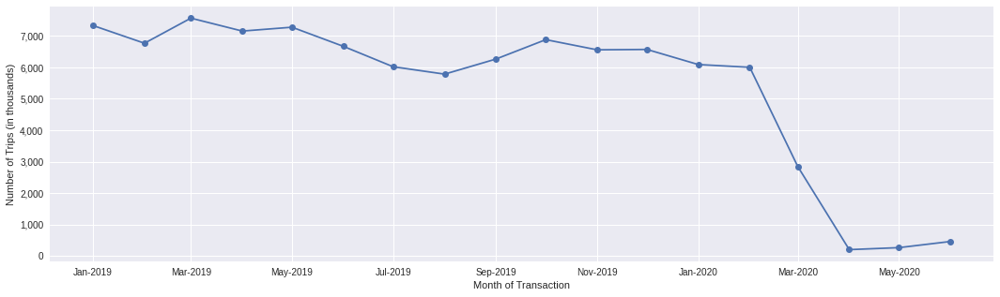

In [16]:
viz = (agg_monthly(df_agg_daily_2019, '2019')
       .append(agg_monthly(df_agg_daily_2020, '2020')))


fig, ax = plt.subplots(figsize=(18,5))

ax.plot_date(viz['date'], viz['trip'], linestyle='-')

ax.get_yaxis().set_major_formatter(
    matplotlib.ticker.FuncFormatter(lambda x,p: format(int(x/1000), ',')))


myFmt = mdates.DateFormatter('%b-%Y')
ax.xaxis.set_major_formatter(myFmt)

ax.set_xlabel('Month of Transaction')
ax.set_ylabel('Number of Trips (in thousands)')
printmd("<a id='fig3'>**Figure 3**</a>. Total monthly taxi transactions "
        "from January 1, 2019 to June 30, 2020.")
plt.show();

Prior to the pandemic, monthly number of transactions would always range from $6$M to $8$M.  January 2020, however, did not attain the monthly total of January 2019.  Instead, it attained 2019’s lowest number of transactions which happened in July-August 2019.  The January 2020 downtrend was sustained in February 2020, and it plummeted fast in March 2020.  These record levels of low continue on until June 2020. 

With this trend in mind, we continue to dissect this behavior in the following questions.

### How has the pandemic affected the daily number of transactions?

To answer this question, we zoom in to 2020 daily patterns presented in [Figure 4](#fig4). 

In [17]:
def agg_daily(df, year):
    """Return a pandas dataframe aggregated daily"""
    df = df.groupby(['month','day'])['trip'].sum().compute().reset_index()
    df['date'] = pd.to_datetime(year + '/' + 
                                df.month.astype(str) + '/' 
                                + df.day.astype(str))
    return df

viz = agg_daily(df_agg_daily_2020, '2020')

<a id='fig4'>**Figure 4**</a>. Total daily taxi transactions from January 1, 2019 to June 30, 2020.

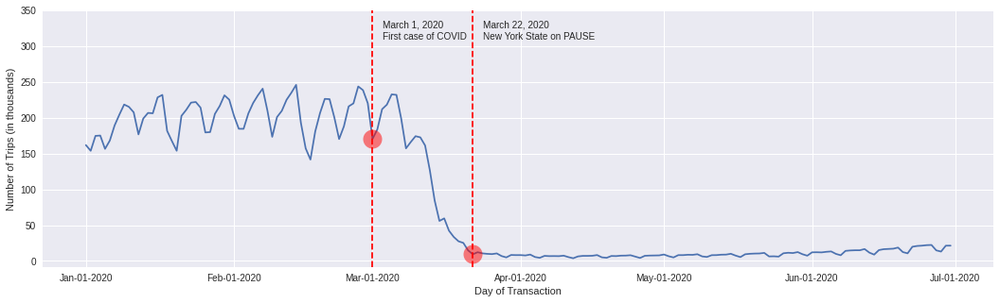

In [18]:
viz = agg_daily(df_agg_daily_2020, '2020')

fig, ax = plt.subplots(figsize=(18,5))

ax.plot_date(viz['date'], viz['trip'], '-')

ax.get_yaxis().set_major_formatter(
    matplotlib.ticker.FuncFormatter(lambda x,p: format(int(x/1000), ',')))

encircled_date = viz['date'][np.where(viz['date']=='2020-03-01')[0][0]]
val_of_encircled_date = viz['trip'][np.where(viz['date']=='2020-03-01')[0][0]]
ax.annotate(text="""
    March 1, 2020
    First case of COVID""",
            xy=(encircled_date, 310_000))

ax.plot_date(encircled_date, val_of_encircled_date,
             marker='o',
             markerfacecolor='red', markersize=20,
             alpha = 0.5)
ax.axvline(x=encircled_date, linestyle='--', color='red')

encircled_date = viz['date'][np.where(viz['date']=='2020-03-22')[0][0]]
val_of_encircled_date = viz['trip'][np.where(viz['date']=='2020-03-22')[0][0]]
ax.annotate(text="""
    March 22, 2020
    New York State on PAUSE""",
            xy=(encircled_date, 310_000))

ax.plot_date(encircled_date, val_of_encircled_date,
             marker='o',
             markerfacecolor='red', markersize=20,
             alpha = 0.5)
ax.axvline(x=encircled_date, linestyle='--', color='red')

myFmt = mdates.DateFormatter('%b-%d-%Y')
ax.xaxis.set_major_formatter(myFmt)

ax.set_xlabel('Day of Transaction')
ax.set_ylabel('Number of Trips (in thousands)')
ax.set_ylim(top=350_000)
printmd("<a id='fig4'>**Figure 4**</a>. Total daily taxi transactions "
        "from January 1, 2019 to June 30, 2020.")
plt.show();

We take note that travel patterns persisted even during the first few days of March, as March 1, 2020 was the first recorded case in NYC.  After March 1, the number of transactions even reached a peak.  When Governor Andrew Cuomo issued stay-at-home orders on March 22 [[11]](#ref11), demand for New York taxis have plummeted.  Upon doing further research, the New York State government never really did issue a travel ban for taxis.  Instead, the quick drop in transactions is a demand-driven impact of the stay-at-home orders to the general New York population.  The period between March 1-21, 2020 also proved to have been a critical time for the New York State government to act quickly and prevent the spread of the virus [[3]](#ref3).  Despite the New York on PAUSE issuance [[11]](#ref11), it was too late; New York State government announced its record high number of cases of 9,000 on April 7, quickly surpassing China’s number of cases [[4]](#ref4).

We also briefly examined what could explain the cyclical highs and lows in the daily number of transactions.  To answer this, found in [Figure 5](#fig5) are calendar plots for the daily number of transactions in 2019 and 2020.

In [43]:
viz = agg_daily(df_agg_daily_2019, '2019').append(
    agg_daily(df_agg_daily_2020, '2020'))

viz['trip'] = np.log(viz['trip'])

<a id='fig5'>**Figure 5**</a>. 2019 and 2020 calendar plots for daily number of transactions.

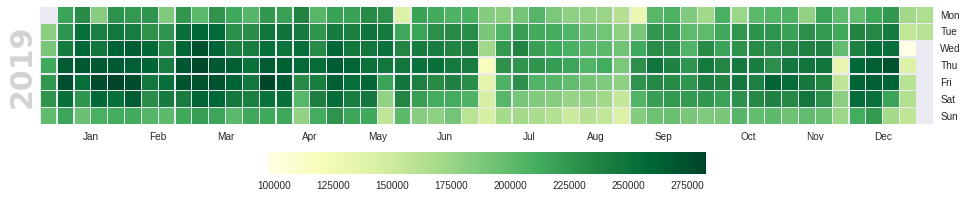

In [44]:
printmd("<a id='fig5'>**Figure 5**</a>. 2019 and 2020 calendar plots for "
        "daily number of transactions.")
viz = agg_daily(df_agg_daily_2019, '2019')
fig, ax = calplot.calplot(viz[['date','trip']].set_index('date').squeeze(),
                          cmap='YlGn',fillcolor='grey',
                          linewidth=0.25, colorbar=False);

cbar = fig.colorbar(ax[0].get_children()[1], fraction=0.08,
                    ax=ax.ravel().tolist(), pad=0.1,
                    orientation='horizontal');

fig.set_size_inches(14,5)
# plt.tight_layout()

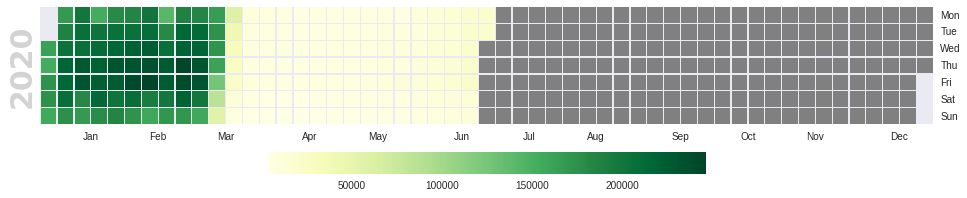

In [21]:
viz = agg_daily(df_agg_daily_2020, '2020')
fig, ax = calplot.calplot(viz[['date','trip']].set_index('date').squeeze(),
                          cmap='YlGn',fillcolor='grey',
                          linewidth=0.25, colorbar=False);

cbar = fig.colorbar(ax[0].get_children()[1], fraction=0.08,
                    ax=ax.ravel().tolist(), pad=0.1, orientation='horizontal');

fig.set_size_inches(14,5)
# plt.tight_layout()

We first examine the 2019 graph. We can infer that bulk of taxi transactions happened during the middle of week, as the darkest shades of greens are found in these rows. In contrast, the lows we found in [Figure 2](#fig2) can be found on Sundays and Mondays, or at the end and at the start of the week.  Light green areas are mostly found on these rows.

The scale drastically changed in 2020. The lightest shade of green starts in the month of March.

### How did payment behavior change due to the pandemic?

The Philippines has seen a spike in cashless transactions since the pandemic hit [[12]](#ref12), and we were expecting the same boom in the United States.  Apparently, this was not the case.  Despite the boom of cashless transactions to minimize contact [[13]](#ref13), the New York City has issued a bill to *ban* cashless transactions in order “to blunt the impact of advancing technology on those who are unable to use it because of financial circumstances, unwilling to for philosophical reasons or vulnerable to its darker aspects” [[14]](#ref14), [[15]](#ref15).

Found in [Figure 6](#fig6) is the monthly proportion of transactions that are paid in cash and cashless.

In [42]:
def agg_monthly_payment_type(df, year):
    """Returns a pandas data frame aggregated monthly by payment_type"""
    df = df.groupby(['month', 'payment_type'])['trip'].sum().compute().reset_index()
    df['date'] = pd.to_datetime(year + '/' + 
                                df.month.astype(str) + '/' 
                                + '1')
    return df

viz = (agg_monthly_payment_type(df_agg_daily_2019, '2019')
       .append(agg_monthly_payment_type(df_agg_daily_2020, '2020')))

viz['payment_type'] = viz['payment_type'].apply(lambda x: 'Cash' if x==2
                                                else 'Cashless')

In [23]:
viz = pd.pivot_table(viz[['trip', 'date', 'payment_type']],
                     columns='payment_type', values='trip',
                     aggfunc=sum, index='date')
data_perc = viz.divide(viz.sum(axis=1), axis=0)*100

<a id='fig6'>**Figure 6**</a>. Proportion of cash and cashless transactions from January 1, 2019 to June 30, 2020.

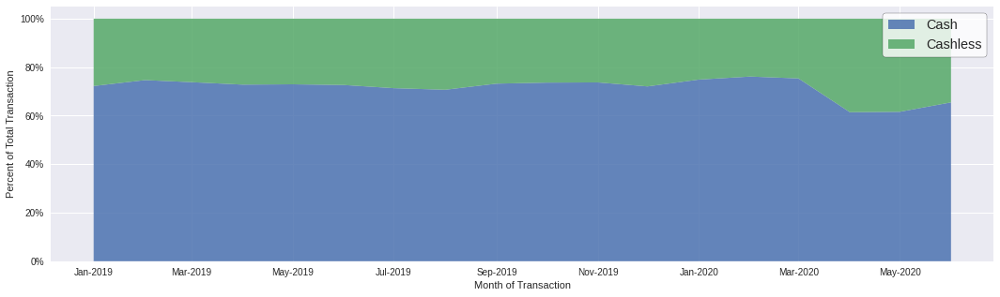

In [24]:
fig, ax = plt.subplots(figsize=(18,5))
ax.stackplot(data_perc.index,
              [data_perc['Cashless'], data_perc['Cash']],
               labels=['Cash', 'Cashless'],
              alpha=0.85)

myFmt = mdates.DateFormatter('%b-%Y')
ax.xaxis.set_major_formatter(myFmt)
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
ax.set_xlabel('Month of Transaction')
ax.set_ylabel('Percent of Total Transaction')
legend = ax.legend(frameon = 1, fontsize='x-large')
frame = legend.get_frame()
frame.set_color('white')
frame.set_edgecolor('black')
printmd("<a id='fig6'>**Figure 6**</a>. Proportion of cash and cashless "
        "transactions from January 1, 2019 to June 30, 2020.")
plt.show();

The pandemic has prompted the use of cashless payment methods by the time the pandemic hit, but as the economy reopened, the proportion of cash transactions has steadily increased. The effect of the bill is evident, as cash still reigns supreme in New York.  It seems that the term “financial inclusion” in the time of pandemic is defined differently between the US and the Philippines.

### When people did take the taxi, were people maintaining social distancing?

Gov. Andrew Cuomo has enacted the 10-point New York State on PAUSE to “assure uniform safety for everyone” [[11]](#ref11).  In particular, the following guidelines greatly drove down taxi demand.

> “4. When in public individuals must practice social distancing of at least six feet from others;”

> “7. Individuals should limit use of public transportation to when absolutely necessary and should limit potential exposure by spacing out at least six feet from other riders;”

However, we asked if these guidelines were still followed in taxi trips.  [Figure 7](#fig7) shows the proportion of transactions with single, couple, and group passengers.

In [25]:
def agg_monthly_passenger_count(df, year):
    """Returns a pandas data frame aggregated monthly by passenger_type"""
    df = df.groupby(['month',
                     'passenger_count'])['trip'].sum().compute().reset_index()
    df['date'] = pd.to_datetime(year + '/' + 
                                df.month.astype(str) + '/' 
                                + '1')
    return df

viz = (agg_monthly_passenger_count(df_agg_daily_2019, '2019')
       .append(agg_monthly_passenger_count(df_agg_daily_2020, '2020')))

viz['passenger_count'] = viz['passenger_count'].replace({1:'Single',
                                                         2:'Couple',
                                                         3:'Group', 4:'Group',
                                                         5:'Group', 6:'Group',
                                                         7:'Group', 8:'Group',
                                                         9:'Group'})

In [26]:
viz = pd.pivot_table(viz[['trip', 'date', 'passenger_count']],
                     columns='passenger_count', values='trip',
                     aggfunc=sum, index='date')

data_perc = viz.divide(viz.sum(axis=1), axis=0)*100

<a id=’fig7’>**Figure 7**</a>. Proportion of passenger count from January 1, 2019 to June 30, 2020.

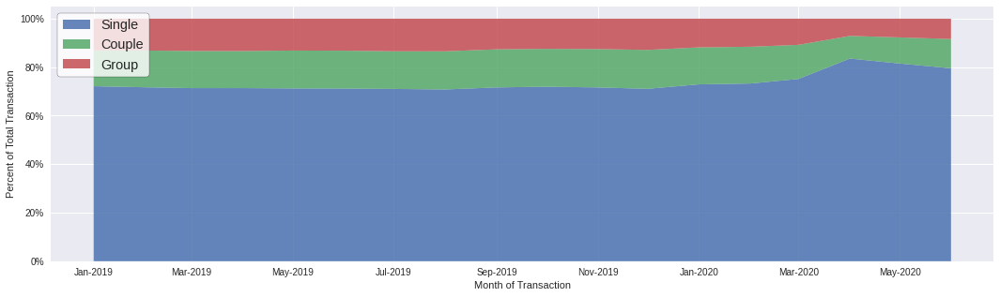

In [27]:
fig, ax = plt.subplots(figsize=(18,5))
ax.stackplot(data_perc.index,
              [data_perc['Single'], data_perc['Couple'], data_perc['Group']],
              labels=['Single', 'Couple', 'Group'],
              alpha=0.85)

myFmt = mdates.DateFormatter('%b-%Y')
ax.xaxis.set_major_formatter(myFmt)
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
ax.set_xlabel('Month of Transaction')
ax.set_ylabel('Percent of Total Transaction')
legend = ax.legend(frameon = 1, loc='upper left', fontsize='x-large')
frame = legend.get_frame()
frame.set_color('white')
frame.set_edgecolor('black')
printmd("<a id=’fig7’>**Figure 7**</a>. Proportion of passenger count "
        "from January 1, 2019 to June 30, 2020.")
plt.show();

Single passengers occupied the largest proportion of all taxi transactions, but this increased further with lockdown measures in place.  Proportion of single passengers slightly dropped with the phased reopening of the NYC economy.  Couple passengers decreased in proportion, but this gradually increased as lockdown measures eased in June 2020.  Group passengers consistently took the smallest share of all transactions, but this shrunk further because of the pandemic.  These observations, plus the fact that ridership has significantly dropped, all indicate that social distancing in taxi rides were followed to the fullest extent.

### Comparing 2019 and 2020 travel patterns, where were people coming from and heading to?

To answer this question, we then proceeded to map the pickup and drop-off zones of taxi rides. These are presented in Figures [8](#fig8) and [9](#fig9).

In [28]:
def agg_monthly_pu_do(df, year, extract='PULocationID'):
    """Return pick-up/drop off location """
    df = df.groupby(['month', 'day',
                     extract])['trip'].sum().compute().reset_index()
    df['date'] = pd.to_datetime(year + '/' + 
                                df.month.astype(str) + '/' 
                                + df.day.astype(str))
    return df

viz = (agg_monthly_pu_do(df_agg_daily_2019, '2019')
       .append(agg_monthly_pu_do(df_agg_daily_2020, '2020')))

In [29]:
# Open shape file
with zipfile.ZipFile('NYC Taxi Zones.zip', 'r') as zip_ref:
    zip_ref.extractall('./shp')
    
fp = './shp/geo_export_3b78f57d-632d-46ba-9dff-906b6c40ea39.shp'
df_shp_zones = gpd.read_file(fp)[['location_i', 'zone', 'geometry']]

In [30]:
viz = pd.merge(viz, df_shp_zones,
                left_on='PULocationID', right_on='location_i', how='left')
viz['trip'] = np.log(viz['trip'])
max_colour = max(viz['trip'])
min_colour = min(viz['trip'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
viz['colour'] = viz['trip'].map(cmap)

viz['date_sec'] = viz['date'].astype(int) / 10**9
viz['date_sec'] = viz['date_sec'].astype(int).astype(str)

In [31]:
# Prepare data for TimeSlider Choropleth

zone_list = viz['zone'].unique().tolist()
zone_idx = range(len(zone_list))

style_dict = {}
for i in zone_idx:
    zone = zone_list[i]
    result = viz[viz['zone'] == zone]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date_sec']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict
    
    
zones_df = viz[['geometry']]
zones_gdf = gpd.GeoDataFrame(zones_df)
zones_gdf = zones_gdf.drop_duplicates().reset_index()

In [32]:
main = folium.Map([40.74, -73.96], width='100%', height='80%',
                  tiles='cartodbpositron', zoom_start=10)


TimeSliderChoropleth(data=zones_gdf.to_json(),
                     styledict=style_dict).add_to(main)

cmap.add_to(main)
cmap.caption = "Log of Number of Transaction"

printmd("<a id=’fig8’>**Figure 8**</a>. Daily number of transactions per zone"
        " by pickup from January 1, 2019 to June 30, 2020.")
main

<a id=’fig8’>**Figure 8**</a>. Daily number of transactions per zone by pickup from January 1, 2019 to June 30, 2020.

In [33]:
viz = (agg_monthly_pu_do(df_agg_daily_2019, '2019', 'DOLocationID')
       .append(agg_monthly_pu_do(df_agg_daily_2020, '2020', 'DOLocationID')))

In [34]:
viz = pd.merge(viz, df_shp_zones,
                left_on='DOLocationID', right_on='location_i', how='left')
viz['trip'] = np.log(viz['trip'])
max_colour = max(viz['trip'])
min_colour = min(viz['trip'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
viz['colour'] = viz['trip'].map(cmap)

viz['date_sec'] = viz['date'].astype(int) / 10**9
viz['date_sec'] = viz['date_sec'].astype(int).astype(str)

In [35]:
# Prepare data for TimeSlider Choropleth

zone_list = viz['zone'].unique().tolist()
zone_idx = range(len(zone_list))

style_dict = {}
for i in zone_idx:
    zone = zone_list[i]
    result = viz[viz['zone'] == zone]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date_sec']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict
    
    
zones_df = viz[['geometry']]
zones_gdf = gpd.GeoDataFrame(zones_df)
zones_gdf = zones_gdf.drop_duplicates().reset_index()

In [36]:
main = folium.Map([40.74, -73.96], width='100%', height='80%',
                  tiles='cartodbpositron', zoom_start=10)


TimeSliderChoropleth(data=zones_gdf.to_json(),
                     styledict=style_dict).add_to(main)

cmap.add_to(main)
cmap.caption = "Log of Number of Transactions"

printmd("<a id=’fig9’>**Figure 9**</a>. Daily number of transactions per zone"
        " by drop-off from January 1, 2019 to June 30, 2020.")
main

<a id=’fig9’>**Figure 9**</a>. Daily number of transactions per zone by drop-off from January 1, 2019 to June 30, 2020.

Based on Figures [8](#fig8) and [9](#fig9), traffic to and from taxi zones significantly decreased.  Heavy traffic zones, indicated in maroon, remained as heavy traffic zones until March 21, 2020. There are hardly any areas that had a shift from being a light traffic zone to a heavy traffic zone.  In general, we can say that wherever the majority of people came from and headed to, they still came from and headed to these areas as the pandemic continued. 

When we compared this to [Figure 2](#fig2), we noticed that there were select zones that point to an overlap in taxi hotspots and COVID-19 hotspots, particularly zones in the West Bronx, Queens, and Brooklyn.  Upon doing further research, we found that these boroughs experienced the worst rates of coronavirus cases, hospitalization, and deaths in the country [[16]](#ref16), [[17]](#ref17). 

### When did people travel?

We also wanted to know if the lockdown measures greatly impeded people from traveling or if it still provided leeway.  With strict lockdown measures, would people not be travelling *at all*? To answer this, we provide a clock plot in [Figure 10](#fig10) that presents the average number of transactions per hour.

In [37]:
def ave_hourly_transactions(df):
    """Return average number of hourly transaction"""
    return (df.groupby(['month', 'day', 'hour'])['trip']
              .count()
              .groupby('hour')
              .mean()
              .compute())

hourly_2019 = ave_hourly_transactions(df_clean_2019)
hourly_2020 = ave_hourly_transactions(df_clean_2020)

In [38]:
# Source: https://chih-ling-hsu.github.io/2018/05/14/NYC
def plt_clock(ax, radii, title, color):
    N = 24
    bottom = 2

    # create theta for 24 hours
    theta = np.linspace(0.0, 2 * np.pi, N, endpoint=False)


    # width of each bin on the plot
    width = (2*np.pi) / N
    
    bars = ax.bar(theta, radii, width=width, bottom=bottom, color=color,
                  edgecolor="#999999")

    
    ax.set_theta_zero_location("N")
    ax.set_theta_direction(-1)

    ax.set_xticks(theta)
    ticks = ["{}:00".format(x) for x in range(24)]
    ax.set_xticklabels(ticks)
    ax.set_title(title)

<a id=’fig10’>**Figure 10**</a>. Average hourly transactions for 2019 and 2020.

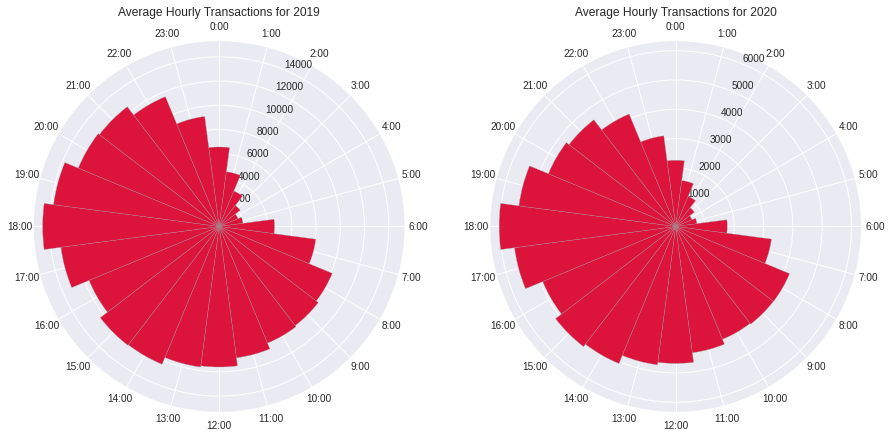

In [39]:
fig, ax = plt.subplots(1,2, figsize=(15,15))

ax = plt.subplot(2,2,1, polar=True)

radii = np.array(hourly_2019.reset_index()['trip'].tolist(), dtype='int64')
title = 'Average Hourly Transactions for 2019'
plt_clock(ax, radii, title, "#dc143c")

ax = plt.subplot(2,2,2, polar=True)

radii = np.array(hourly_2020.reset_index()['trip'].tolist(), dtype='int64')
title = 'Average Hourly Transactions for 2020'
printmd("<a id=’fig10’>**Figure 10**</a>. Average hourly transactions for 2019"
        " and 2020.")
plt_clock(ax, radii, title, "#dc143c")

The general shape and distribution of 2020 generally follows the 2019 graph.  The peak average still occurs at 18:00, while the trough happens from 01:00 to 05:00.  However, the significant change is seen in the scales.  At all times, the average hourly transactions of 2020 are reduced to less than half of 2019.

### Since New York has implemented a phased reopening, how did this affect mobility of New Yorkers?

In [40]:
%%html
<style> 
table td, table th, table tr {text-align:left !important;}
</style>

Consistent as well with the news is the phased reopening plan of New York City. Found in [Table 2](#tab2) are the pertinent details of the reopening plan [[18]](#ref18).

<a id=’tab2’>**Table 2**</a>. NYC reopening plan.

| Date | Phase | Permitted activities | Estimated number <br/> of workers coming back |
| :-: | - | - | - |
| June 8 | Phase 1 | construction, manufacturing, agriculture, forestry, fishing, and select retail that can offer curbside pickup. | 200,00 – 400,000 [[19]](#ref19) |
| June 22 | Phase 2 | outdoor dining at restaurants, hair salons and barber shops, offices, real estate firms, in-store retail, vehicle sales, retail rental, repair services, cleaning services, and commercial building management. | 300,000 [[20]](#ref20)
| July 6 | Phase 3 | indoor dining at restaurants and bars at 50% capacity (excluding New York City) <br/> and personal care services. | No information |
| July 22 | Phase 4 | low-risk outdoor activities at 33% capacity (outdoor zoos, botanical gardens, nature parks, historical sites, outdoor museums, etc.); low-risk indoor activities at 25% capacity are allowed in Phase 4 regions outside of New York City. | No information |


Our dataset captures travel activity until Phase 2, and this is presented in [Figure 11](#fig11).

<a id='fig11'>**Figure 11**</a>. Daily number of transactions from May 1 to June 30, 2020.

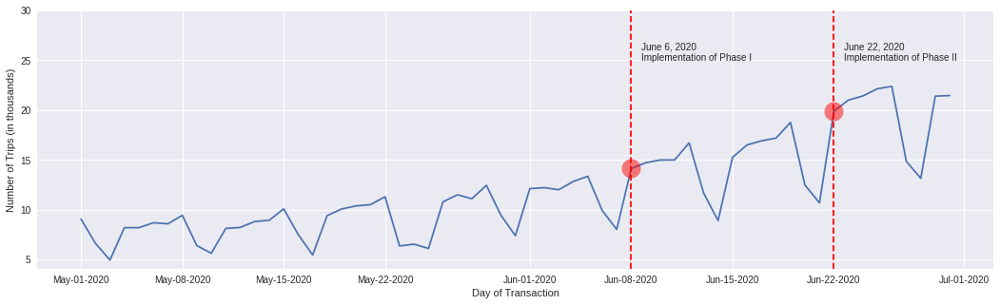

In [41]:
viz = agg_daily(df_agg_daily_2020, '2020')

fig, ax = plt.subplots(figsize=(18,5))
viz = viz[viz['month']>=5].reset_index(drop=True)
ax.plot_date(viz['date'], viz['trip'], '-')

ax.get_yaxis().set_major_formatter(
    matplotlib.ticker.FuncFormatter(lambda x,p: format(int(x/1000), ',')))

myFmt = mdates.DateFormatter('%b-%d-%Y')
ax.xaxis.set_major_formatter(myFmt)

# Annotation
encircled_date = viz['date'][np.where(viz['date']=='2020-06-08')[0][0]]
val_of_encircled_date = viz['trip'][np.where(viz['date']=='2020-06-08')[0][0]]
ax.annotate(text="""
    June 6, 2020
    Implementation of Phase I""",
            xy=(encircled_date, 25_000))

ax.plot_date(encircled_date, val_of_encircled_date,
             marker='o',
             markerfacecolor='red', markersize=20,
             alpha = 0.5)
ax.axvline(x=encircled_date, linestyle='--', color='red')

# # Annotation
encircled_date = viz['date'][np.where(viz['date']=='2020-06-22')[0][0]]
val_of_encircled_date = viz['trip'][np.where(viz['date']=='2020-06-22')[0][0]]
ax.annotate(text="""
    June 22, 2020
    Implementation of Phase II""",
            xy=(encircled_date, 25_000))

ax.plot_date(encircled_date, val_of_encircled_date,
             marker='o',
             markerfacecolor='red', markersize=20,
             alpha = 0.5)
ax.axvline(x=encircled_date, linestyle='--', color='red')


ax.set_xlabel('Day of Transaction')
ax.set_ylabel('Number of Trips (in thousands)')
ax.set_ylim(top=30_000)
printmd("<a id='fig11'>**Figure 11**</a>. Daily number of transactions from"
        " May 1 to June 30, 2020.")
plt.show();

With the implementation of the phased opening, the cyclical graph now has an upward trajectory, signifying increased ridership as the economy further opens and more people come back to work.  Consistent with our findings in [Figure 4](#fig4) and [Figure 5](#fig5), the cyclical nature persists because of the low ridership on weekends. In 2020, this pattern persists as non-essential travel is still discouraged by the New York State government.

<div><span style="background-color: #425564; padding-top: 100px; padding-right: 20px; padding-bottom: 50px; padding-left: 20px; color: #ffffff; font-size: 20px; font-weight: bold"> CONCLUSION AND RECOMMENDATIONS </span></div>

In understanding mobility in the time of pandemic, we should contextualize it to the events and government response at the time.  With non-essential travel prohibited by the government, demand for taxi rides experienced a significant drop despite having no explicit ban from the New York State government.  When people do travel, New Yorkers are compliant with rules, as they mostly ride taxis alone.  However, because of a ban on cashless transactions for the sake of financial inclusion, cash transactions still oddly reign supreme in the time of a pandemic. In terms of travel patterns, there have been no significant change in where people are headed to, coming from, and what time they leave.  The effects of the pandemic for taxi rides are seen instead in the volume of transactions, thus negatively affecting the livelihoods of taxi drivers.  With the reopening of New York in June 6, 2020, we are seeing an upward trajectory in the number of transactions, and we expect for this upward, cyclical trend to continue as the months pass.

Today, New York is still in Phase 4 of its reopening plan.  In Phase 4, indoor dining and nonessential businesses are allowed to open and resume business, and hopefully this means more trips with precautionary measures for NYC taxi drivers.  We await updated figures from the NYC TLC to map travel behavior along with more recent events. 

To further improve the study, we recommend the following:
1. Mapping interzone travel along with movement of COVID-19 patients to see how the virus spread in New York;
2. Conducting unsupervised learning on taxi transactions and mapping this along with COVID-19 hotspots to find similar characteristics in the movement of individuals; and
3. Include transactions made through ride-hailing apps to provide a bigger picture on the effects of the pandemic in the on-demand transportation industry.

<div><span style="background-color: #425564; padding-top: 100px; padding-right: 20px; padding-bottom: 50px; padding-left: 20px; color: #ffffff; font-size: 20px; font-weight: bold"> REFERENCES </span></div>

<a id='ref1'>[1]</a> World Health Organization. (2020). Timeline of WHO’s response to COVID-19. Retrieved on November 25, 2020 from https://www.who.int/news/item/29-06-2020-covidtimeline

<a id='ref2'>[2]</a> Goldstein, J. and McKinley, J. (2020). Coronavirus in N.Y.: Manhattan Woman Is First Confirmed Case in State. Accessed on November 28, 2020 from https://www.nytimes.com/2020/03/01/nyregion/new-york-coronvirus-confirmed.html

<a id='ref3'>[3]</a> Edelman, S. (2020). Two pols urge de Blasio to oust Health Commissioner Barbot over coronavirus response. Accessed on November 28, 2020 from https://nypost.com/2020/04/04/nyc-pols-urge-de-blasio-to-oust-health-commissioner-over-coronavirus-response/

<a id='ref4'>[4]</a> Dzhanova, Y. (2020). New York state now has more coronavirus cases than any country outside the US. Accessed on November 27, 2020 from https://www.cnbc.com/2020/04/10/new-york-state-now-has-more-coronavirus-cases-than-any-country-outside-the-us.html

<a id='ref5'>[5]</a> Clarke, S. (2020). New York’s Economy Fares Worst Amid Pandemic, Report Shows. US News. Accessed on November 30, 2020 from https://www.usnews.com/news/best-states/articles/2020-08-27/new-yorks-economy-suffering-most-during-coronavirus

<a id='ref6'>[6]</a> Registry of Open Data on AWS. (n.d.). New York City Taxi and Limousine Commission (TLC) Trip Record Data. Accessed on November 20, 2020 from https://registry.opendata.aws/nyc-tlc-trip-records-pds/	

<a id='ref7'>[7]</a> NYC Open Data. (n.d.). NYC Taxi Zones. Accessed on November 22, 2020 from https://data.cityofnewyork.us/Transportation/NYC-Taxi-Zones/d3c5-ddgc

<a id='ref8'>[8]</a> Bianco, F. (2015). NYC JSON cartographic file with ZIP Code Tabulation Areas (ZCTAs). Accessed on November 27, 2020 from https://github.com/fedhere/PUI2015_EC

<a id='ref9'>[9]</a> NYC Department of Health and Mental Hygiene. (2020). NYC Coronavirus Disease 2019 (COVID-19) Data. Github. Accessed on November 29, 2020 from https://github.com/nychealth/coronavirus-data

<a id='ref10'>[10]</a> McEvoy, J. (2020). New York Taxi Drivers Shut Down Bridges In Desperate Call To End ‘Life Sentence To Debtor’s Prison’. Forbes. Accessed on November 28, 2020 from https://www.forbes.com/sites/jemimamcevoy/2020/09/17/new-york-taxi-drivers-shut-down-bridges-in-desperate-call-to-end-life-sentence-to-debtors-prison/?sh=55f2f064111e

<a id='ref11'>[11]</a> New York State. Governor Cuomo Signs the 'New York State on PAUSE' Executive Order.  Accessed on November 26, 2020 from https://www.governor.ny.gov/news/governor-cuomo-signs-new-york-state-pause-executive-order

<a id='ref12'>[12]</a> Devanesan, J. (2020). The Philippines is going cashless – finally. TechWire Asia.  Accessed on November 29, 2020 from https://techwireasia.com/2020/07/digital-payments-are-finally-soaring-in-the-philippines/

<a id='ref13'>[13]</a> Nunez, A. (2020). New research suggests the coronavirus could live on cash, pushing consumers toward digital payments.  Business Insider. Accessed on November 29, 2020 from https://www.businessinsider.com/coronavirus-remaining-on-cash-may-accelerate-cashless-adoption-2020-10

<a id='ref14'>[14]</a> Shanahan, E. and Mays, J.C. (2020). New York City Stores Must Accept Cash, Council Says. The New York Times. Accessed on November 29, 2020 from https://www.nytimes.com/2020/01/23/nyregion/nyc-cashless-ban.html

<a id='ref15'>[15]</a> Deffenbaugh, R. (2020). City ban on cashless stores looms even as digital payments grow. Crain’s New York Business. Accessed on November 28, 2020 from https://www.crainsnewyork.com/technology/city-ban-cashless-stores-looms-even-digital-payments-grow

<a id='ref16'>[16]</a> De Freytas-Tamura, K., Hu, W., and Cook, R. (2020). ‘It’s the Death Towers’: How the Bronx Became New York’s Virus Hot Spot. The New York Times. Accessed on November 30, 2020 from https://www.nytimes.com/2020/05/26/nyregion/bronx-coronavirus-outbreak.html

<a id='ref17'>[17]</a> Honan, K. (2020). The New York Neighborhoods With the Most Coronavirus Cases. The Wall Street Journal. Accessed on November 30, 2020 from https://www.wsj.com/articles/the-new-york-neighborhoods-with-the-most-coronavirus-cases-11585781164

<a id='ref18'>[18]</a> Weaver, S. (2020). Here's what will reopen in NYC in Phase 1, according to the mayor. TimeOut. Accessed on November 28, 2020 from https://www.timeout.com/newyork/news/heres-what-will-reopen-in-nyc-in-phase-1-according-to-the-mayor-060520

<a id='ref13'>[19]</a> Gold, M. (2020). New York City Will Enter Next Phase of Reopening on Monday, Mayor Says. The New York Times. Accessed on November 28, 2020 from https://www.nytimes.com/2020/06/18/nyregion/phase-2-reopening-nyc.html

<a id='ref13'>[20]</a> Gold, M. and Stevents, M. (2020). What Restrictions on Reopening Remain in New York?. The New York Times. Accessed on November 30, 2020 from https://www.nytimes.com/article/new-york-phase-reopening.html